In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from scipy import stats
from scipy.stats import norm
from scipy.stats import chi2_contingency
from scipy.stats import pearsonr
import plotly.express as px
from plotly.subplots import make_subplots
from statsmodels.graphics.tsaplots import month_plot
import plotly.graph_objs as go
import calendar

In [14]:
df = pd.read_csv('data/weatherstats_vancouver_hourly_clean.csv')
df.head()

,date_time_local,pressure_station,pressure_sea,wind_dir,wind_speed,wind_gust,relative_humidity,dew_point,temperature,windchill,humidex,visibility,health_index,cloud_okta,max_air_temp_pst1hr,min_air_temp_pst1hr
0,2013-07-01 00:00:00,101.18,101.16,SSE,7,0.0,91,18.2,19.7,0.0,0.0,32200.0,2.9,5.0,19.4,18.5
1,2013-07-01 01:00:00,101.22,101.21,SE,6,0.0,89,17.8,19.6,0.0,0.0,32200.0,3.0,5.0,20.1,18.7
2,2013-07-01 02:00:00,101.26,101.24,E,11,0.0,88,16.7,18.7,0.0,0.0,32200.0,3.0,5.0,19.8,18.0
3,2013-07-01 03:00:00,101.26,101.25,E,4,0.0,84,16.5,19.2,0.0,0.0,32200.0,2.7,5.0,18.5,17.5
4,2013-07-01 04:00:00,101.30,101.28,NNW,5,0.0,87,15.7,17.9,0.0,0.0,32200.0,2.6,5.0,18.8,17.3


In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87648 entries, 0 to 87647
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   date_time_local      87648 non-null  object 
 1   pressure_station     87648 non-null  float64
 2   pressure_sea         87648 non-null  float64
 3   wind_dir             87648 non-null  object 
 4   wind_speed           87648 non-null  int64  
 5   wind_gust            87648 non-null  float64
 6   relative_humidity    87648 non-null  int64  
 7   dew_point            87648 non-null  float64
 8   temperature          87648 non-null  float64
 9   windchill            87648 non-null  float64
 10  humidex              87648 non-null  float64
 11  visibility           87648 non-null  float64
 12  health_index         87648 non-null  float64
 13  cloud_okta           87648 non-null  float64
 14  max_air_temp_pst1hr  87648 non-null  float64
 15  min_air_temp_pst1hr  87648 non-null 

In [16]:
df['date_time_local'] = pd.to_datetime(df['date_time_local'], utc=False)
df = df.set_index('date_time_local')
df.head()

,pressure_station,pressure_sea,wind_dir,wind_speed,wind_gust,relative_humidity,dew_point,temperature,windchill,humidex,visibility,health_index,cloud_okta,max_air_temp_pst1hr,min_air_temp_pst1hr
date_time_local,,,,,,,,,,,,,,,
2013-07-01 00:00:00,101.18,101.16,SSE,7,0.0,91,18.2,19.7,0.0,0.0,32200.0,2.9,5.0,19.4,18.5
2013-07-01 01:00:00,101.22,101.21,SE,6,0.0,89,17.8,19.6,0.0,0.0,32200.0,3.0,5.0,20.1,18.7
2013-07-01 02:00:00,101.26,101.24,E,11,0.0,88,16.7,18.7,0.0,0.0,32200.0,3.0,5.0,19.8,18.0
2013-07-01 03:00:00,101.26,101.25,E,4,0.0,84,16.5,19.2,0.0,0.0,32200.0,2.7,5.0,18.5,17.5
2013-07-01 04:00:00,101.30,101.28,NNW,5,0.0,87,15.7,17.9,0.0,0.0,32200.0,2.6,5.0,18.8,17.3


In [40]:
df2 = df[['wind_speed', 'wind_gust', 'temperature', 'windchill', 'humidex', 'dew_point']]

In [41]:
fig = px.line(df, x=df2.index, y=df2.columns,)

# axis labels and title
fig.update_layout(
    yaxis_title="Measurement", 
    legend_title="", 
    title="July 2013 to June 2023 Vancouver Weather Stats"
)

# activate slider
fig.update_xaxes(rangeslider_visible=True)

fig.show()

Few things to note from this previous graph. We already know that dew point and temperature are related to the humidex, and that temperature and wind speed are related to wind chill. In the graph we see that the lower the dewpoint higher than 10 results in a humidex that is not 0. For windchill, the temperature is way more important than the wind speed. For example, you could have a very windy day but the temperature is over 0 and therefore there is no windchill factor. Like wise, you can have temperature below 0 and the wind speed may not be too high but you still have a high windchill factor.

In [19]:
df2_monthly = df2.resample("MS").mean()

df2_monthly.head()

,pressure_station,pressure_sea,wind_speed,wind_gust,relative_humidity,dew_point,temperature,windchill,humidex,visibility,health_index,cloud_okta,max_air_temp_pst1hr,min_air_temp_pst1hr
date_time_local,,,,,,,,,,,,,,
2013-07-01,101.641949,101.644086,13.928763,0.000000,73.170699,13.483737,18.457527,0.000000,8.788978,41483.333333,2.251882,5.000000,19.331720,18.007258
2013-08-01,101.480739,101.484825,12.366935,0.342742,77.212366,14.270833,18.443145,0.000000,8.071237,33750.268817,2.074462,5.000000,19.309274,18.038038
2013-09-01,101.085222,101.060819,12.741667,2.688889,86.237500,13.043194,15.384444,0.000000,2.008333,28389.722222,2.138333,5.000000,16.052361,15.027778
2013-10-01,102.047272,102.082675,9.686828,0.580645,88.068548,7.311559,9.302554,0.000000,0.029570,23551.478495,2.025403,4.763441,9.817473,8.857258
2013-11-01,101.887240,101.947129,11.680999,3.586685,86.091540,4.013454,6.237032,-0.223301,0.000000,28338.557559,2.416089,6.392510,6.744660,5.773093


In [21]:
fig = px.line(df2_monthly, x=df2_monthly.index, y='temperature',)
fig.update_layout(
    yaxis_title="Degrees", 
    xaxis_title="Year",
    legend_title="", 
    title="Monthly Temperature Average from July 2013 - June 2023"
)
fig.show()

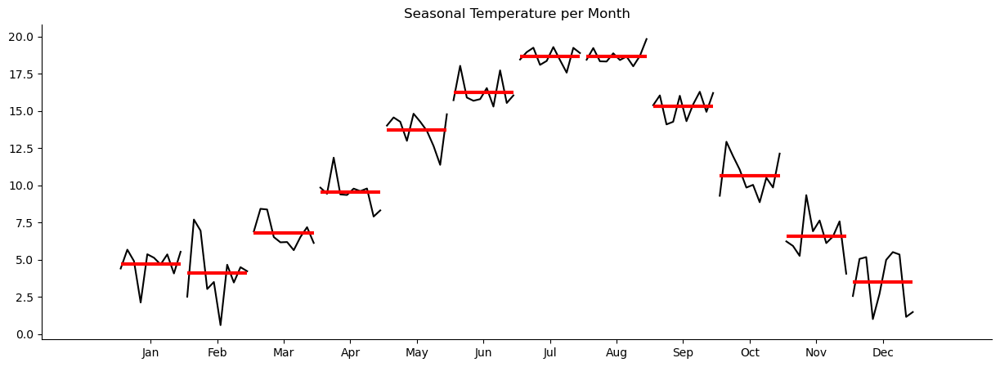

In [23]:
plt.figure(figsize=(15, 5))

month_plot(df2_monthly["temperature"], ax=plt.gca())

plt.title("Seasonal Temperature per Month")
sns.despine()
plt.show()

In [24]:
# monthly average
monthly_mean = df2_monthly.groupby(df2_monthly.index.month_name()).mean()

# relative deviation from the overall mean
monthly_mean_diff = (monthly_mean - monthly_mean.mean())/monthly_mean

# month names in right order
month_names = pd.date_range(start='2000-01', freq='M', periods=12).month_name()

# reorder columns to follow the month order
monthly_mean_diff = monthly_mean_diff.loc[month_names, ]

monthly_mean_diff.T

,January,February,March,April,May,June,July,August,September,October,November,December
pressure_station,0.000638,0.001180,-0.000195,0.000350,-0.000497,-0.000360,0.000169,-0.001144,-0.001262,0.000093,0.000324,0.000699
pressure_sea,0.000713,0.001256,-0.000159,0.000328,-0.000528,-0.000403,0.000072,-0.001219,-0.001332,0.000140,0.000381,0.000744
wind_speed,-0.010779,-0.018081,0.024558,0.085258,-0.013443,0.046198,0.027038,-0.047885,-0.048915,-0.074073,0.016979,-0.008973
wind_gust,0.140138,0.076704,0.099583,0.213015,-0.308017,-0.155097,-0.364000,-0.714691,-0.361863,-0.053874,0.334886,0.193177
relative_humidity,0.091570,0.018443,-0.007440,-0.057806,-0.062107,-0.096614,-0.103076,-0.056724,0.015557,0.066813,0.063281,0.075092
dew_point,-1.444883,-5.419721,-1.120576,-0.357451,0.224546,0.351991,0.460484,0.486564,0.392999,0.127736,-0.696355,-3.769862
temperature,-1.263719,-1.599103,-0.572820,-0.123730,0.220597,0.340028,0.425848,0.426697,0.300070,-0.005500,-0.631110,-2.055710
windchill,0.517816,0.725918,-3.370184,-114.665767,inf,inf,inf,inf,inf,-64.942782,0.100377,0.796473
humidex,-inf,-inf,-inf,-51.668624,-1.281800,0.427875,0.776488,0.770908,-0.058049,-92.881823,-inf,-inf
visibility,-0.223152,-0.109118,-0.025184,0.056320,0.117938,0.153035,0.188044,0.082201,-0.007398,-0.122221,-0.105744,-0.216484
